# Assignment: Features, Matching and Homographies
- Alumno 1: David Lázaro Martín
- Alumno 2: Nicolás Vega Muñoz
- Alumno 3: Lara Herrera Fernández

The goal of the programming project in the “Fundamentos de Análisis de Imagen” course is to put into practice your understanding of the material covered in class to develop proficiency in using OpenCV for digital image processing, emphasizing fundamentals of feature representation and scene stitching.

Follow the link above to download the images: [https://drive.upm.es/s/mW7CrA0V6idTTvW](https://drive.upm.es/s/mW7CrA0V6idTTvW)

In [2]:
import os
import cv2
import copy
import itertools
import numpy as np
import matplotlib.pyplot as plt
import numpy as np
from sklearn import linear_model
print("OpenCV " + cv2.__version__)

OpenCV 4.6.0


In [3]:

plt.rcParams['figure.figsize'] = [40, 10] # figure size in inches

def draw_images(imgs):
    if len(imgs) > 1:
        fig, axs = plt.subplots(1, len(imgs))
        for idx, img in enumerate(imgs):
            axs[idx].axis("off")
            axs[idx].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
            # axs[idx].imshow(img)
    else:
        fig, ax = plt.subplots()
        ax.axis("off")
        ax.imshow(imgs[0])
    plt.show()

## **Part 1: Homography-based planar object detection (4 pts)**

In [105]:
filenames = ["images/pkmn.png", "images/bus.png"]

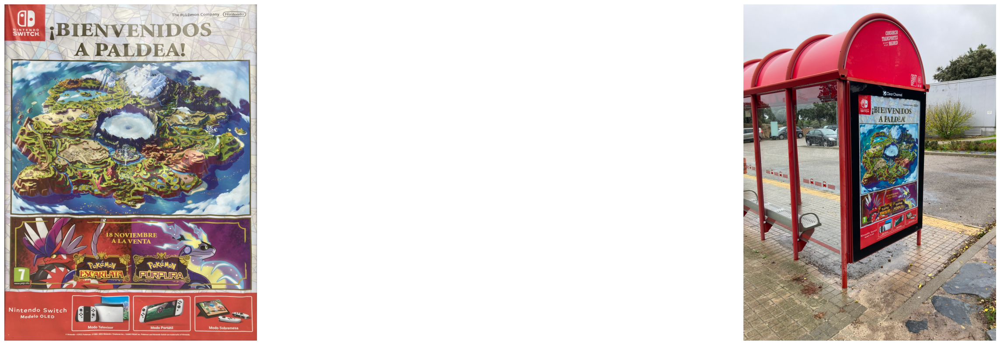

In [106]:
### TODO
# Draw images
imgs = [cv2.imread(img) for img in filenames]
draw_images(imgs)

#### Detect keypoints and extract local invariant descriptors from the two input images.

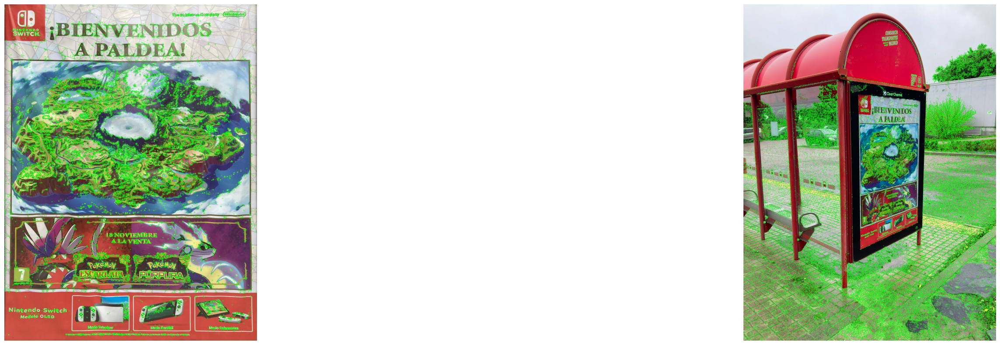

In [107]:
#probar con varios métodos y decidir cuál es el mejor se valora más que si coges una y lo pones sin más.


#####IMPORTANTE LO DE PROBAR MÁS METODOS!!!!!



# Draw key points
sift =  cv2.SIFT_create()

_imgs = copy.deepcopy(imgs)
pokemon_gray = cv2.cvtColor(_imgs[0], cv2.COLOR_BGR2GRAY)
bus_gray = cv2.cvtColor(_imgs[1], cv2.COLOR_BGR2GRAY)

kp1,des1 = sift.detectAndCompute(pokemon_gray, None)
kp2,des2 = sift.detectAndCompute(bus_gray,None)
keypoints = [kp1,kp2]

for idx in range(len(_imgs)):
    cv2.drawKeypoints(_imgs[idx], keypoints[idx], _imgs[idx], (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images(_imgs)


#### Match the descriptors between the two images.

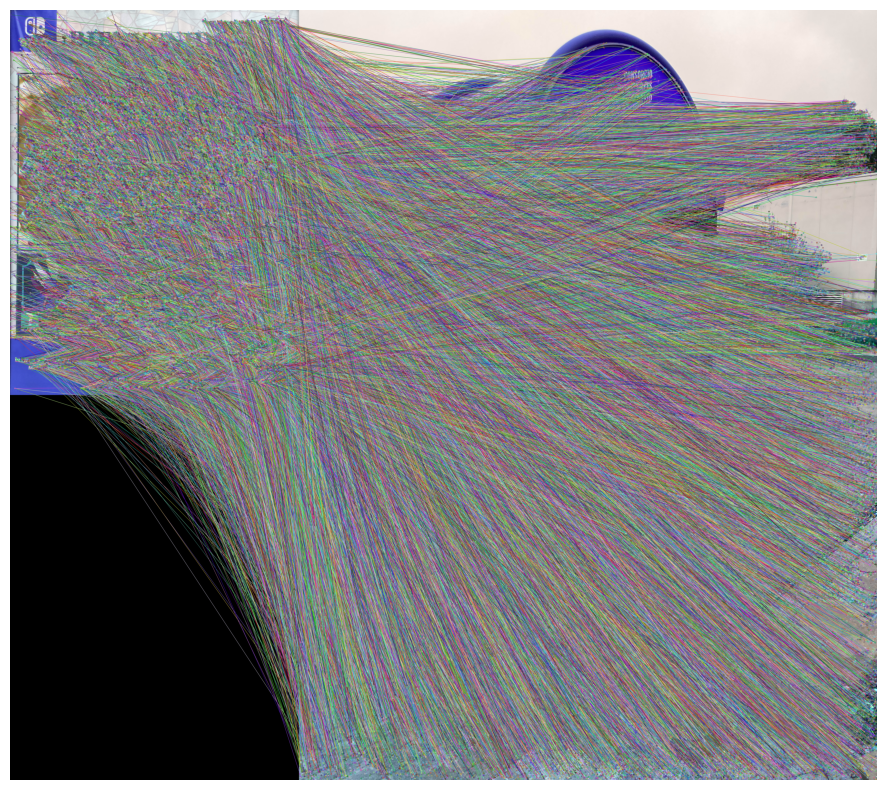

19603


In [54]:
### TODO
## probar aqui tb con diferentes metodos de match y con diferentes k y comparar en la memoria, cambiar la distancia si el descriptor es binario o no
#si ponemos k>1 crosscheck = false
#Si knn draw matchesknn
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = bf.knnMatch(des1,des2,k=2)
img = cv2.drawMatchesKnn(imgs[0], keypoints[0], imgs[1], keypoints[1], matches, None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images([img])
print(len(matches))

#### Use the RANSAC algorithm to estimate a homography matrix H using the matched feature vectors and draw correct matches.

1161


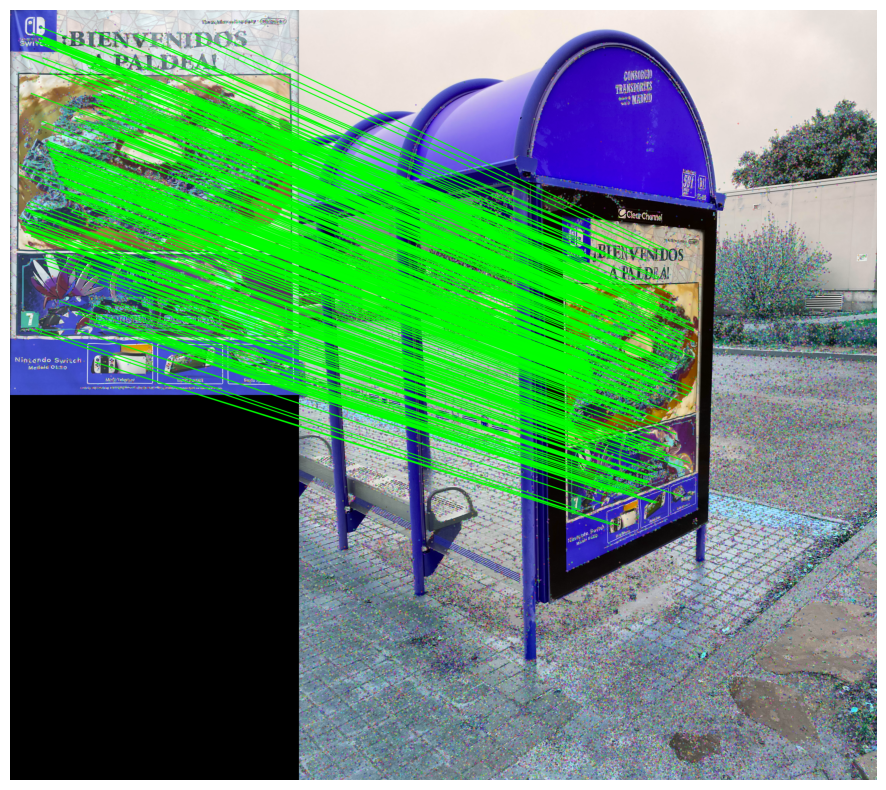

In [55]:
### TODO
good = []
for m, n in matches:
    if m.distance < 0.80 * n.distance:
        good.append(m)
print(len(good))
src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in good ]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints[1][m.trainIdx].pt for m in good ]).reshape(-1,1,2)
H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,5.0)
h,w,_ = _imgs[0].shape


draw_params = dict(matchColor=(0,255,0), singlePointColor=None, matchesMask=inliers.ravel().tolist(), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
img = cv2.drawMatches(imgs[0], keypoints[0], imgs[1], keypoints[1], good, None, matchesThickness=3, **draw_params)
draw_images([img])

#### Once camera resectioning is done from an estimated homography, this information is used to insert another image, with the correct perspective, appearing to be part of the original scene.

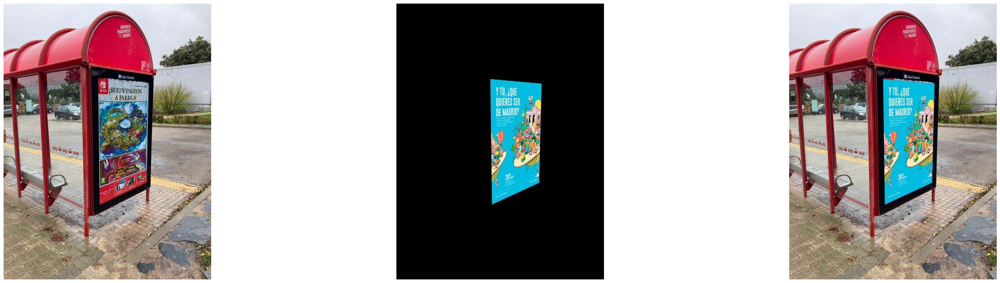

In [56]:
### TODO
# Draw overlay

ayto = cv2.imread('./images/ayto.png')
proj_img = cv2.warpPerspective(cv2.resize(ayto,(w,h)), H, (3024,4032))

mask = cv2.inRange(proj_img, 0,0) 
mask_inv = cv2.bitwise_not(mask)
cartel = cv2.bitwise_and(proj_img,proj_img,mask = mask_inv)
fondo = cv2.bitwise_and(imgs[1],imgs[1],mask = mask)
overlay = cv2.add(fondo,cartel)

draw_images([imgs[1], proj_img, overlay])

## **Part 2: Stitch multiple images together to create a wide view panorama (5 pts)**

In [108]:
filenames = ["images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png"]

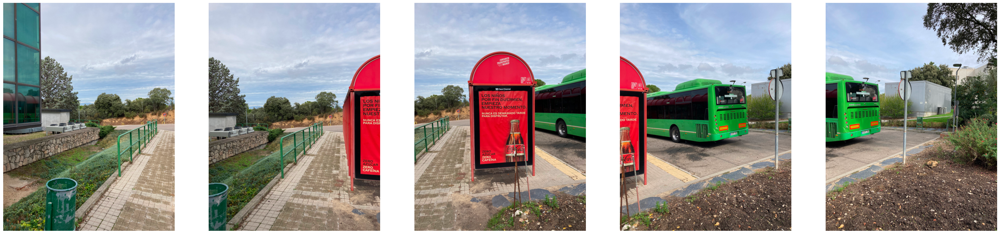

In [109]:
### TODO
# Draw images
imgs = [cv2.imread(img) for img in filenames]
draw_images(imgs)

#### The goal of this part of the assignment is to combine five horizontally overlapping photographs into a single panoramic image. Images must be supplied in left-to-right order.

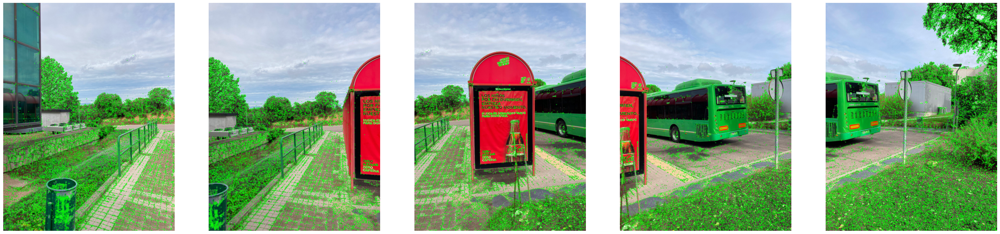

In [110]:
### TODO
# Draw key points
sift =  cv2.SIFT_create()

_imgs = copy.deepcopy(imgs)
gray_imgs = []
for img in _imgs:
    gray_imgs += [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)]

keypoints = []
descriptores = []
for img in gray_imgs:
    kp, des = sift.detectAndCompute(img, None)
    keypoints += [kp]
    descriptores += [des]

for idx in range(len(_imgs)):
    cv2.drawKeypoints(_imgs[idx], keypoints[idx], _imgs[idx], (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images(_imgs)

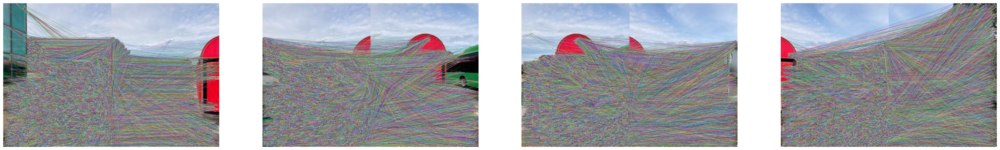

In [111]:
### TODO
# Draw all matches
pairs = []
for i in range(len(imgs)-1):
    pairs += [(i,i+1)]

bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = []
for i,j in pairs:
    matches += [bf.knnMatch(descriptores[i],descriptores[j],k=2)]
_imgs = []
for idx, (elem1, elem2) in enumerate(pairs):
    _imgs.append(cv2.drawMatchesKnn(imgs[elem1], keypoints[elem1], imgs[elem2], keypoints[elem2], matches[idx], None, flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT))
draw_images(_imgs)

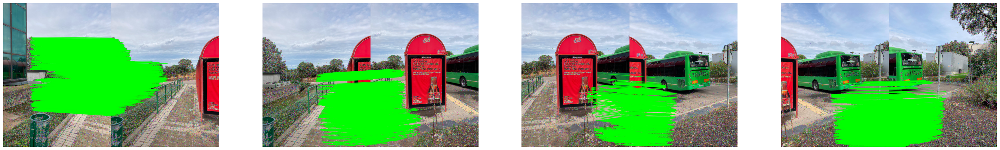

[array([[ 1.49578168e+01, -4.93286058e-01, -6.23847212e+04],
        [ 7.13195153e+00,  7.32005774e+00, -5.95914584e+04],
        [ 8.07053800e-04, -5.06787776e-05,  1.00000000e+00]]),
 array([[-2.15140489e+00, -3.17052619e-02,  1.41002897e+04],
        [-1.53943044e+00, -7.95826291e-01,  1.50456588e+04],
        [-1.73102535e-04, -1.21353067e-05,  1.00000000e+00]]),
 array([[-1.79118371e+00, -5.33929672e-02,  1.27669199e+04],
        [-1.39035539e+00, -5.96899699e-01,  1.36491851e+04],
        [-1.53702060e-04, -9.42951221e-06,  1.00000000e+00]]),
 array([[-2.53943393e+00,  1.50414935e-03,  1.57010096e+04],
        [-1.78944595e+00, -9.38924481e-01,  1.68872702e+04],
        [-1.98113625e-04, -7.84506831e-06,  1.00000000e+00]])]

In [112]:
### TODO
# Draw correct matches
Hs = []
masks_inliers = []
shapes = []
goods = []
top  = 8000
left = 8000
rigth = 8000
bot = 8000
for i,j in pairs:
    good = []
    for m, n in matches[i]:
        if m.distance < 0.70 * n.distance:
            good.append(m)
    goods += [good]
    src_pts = np.float32([ keypoints[i][m.queryIdx].pt for m in good ]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints[j][m.trainIdx].pt for m in good ]).reshape(-1,1,2)
    for k in range(len(src_pts)):
        src_pts[k][0] = (src_pts[k][0][0]+left,src_pts[k][0][1]+top)
    for k in range(len(dst_pts)):
        dst_pts[k][0] = (dst_pts[k][0][0]+left,dst_pts[k][0][1]+top)
    H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)
    Hs += [H]
    masks_inliers += [inliers]
    # h,w,_ = _imgs[i].shape
    # shapes += [(h,w)]

_imgs = []
for idx, (elem1, elem2) in enumerate(pairs):
    draw_params = dict(matchColor=(0,255,0), singlePointColor=None, matchesMask=masks_inliers[idx].ravel().tolist(), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
    _imgs.append(cv2.drawMatches(imgs[elem1], keypoints[elem1], imgs[elem2], keypoints[elem2], goods[idx], None, matchesThickness=3, **draw_params))
draw_images(_imgs)
Hs
# Hs[0] = np.matmul(Hs[0],Hs[1])
# Hs[3] = np.matmul(Hs[3],Hs[2])

In [113]:
from numpy.linalg import inv, det
fija = len(imgs)//2
matrices = [np.eye(3,3) for i in range(len(imgs))]

for index in range(fija):
    matrices[fija-index-1]=matrices[fija-index]@Hs[fija-index-1]

for index in range(fija+1,len(imgs)):
    matrices[index]=Hs[index-1]@matrices[index-1]
print(matrices)
for index in range(fija):
    print(index)
    matrices[index]=inv(matrices[index])

[array([[-2.10267482e+01,  1.14588242e-01,  1.50204447e+05],
       [-1.65596570e+01, -5.82861043e+00,  1.58507047e+05],
       [-1.86873062e-03, -5.41208566e-05,  1.25221140e+01]]), array([[-2.15140489e+00, -3.17052619e-02,  1.41002897e+04],
       [-1.53943044e+00, -7.95826291e-01,  1.50456588e+04],
       [-1.73102535e-04, -1.21353067e-05,  1.00000000e+00]]), array([[1., 0., 0.],
       [0., 1., 0.],
       [0., 0., 1.]]), array([[-1.79118371e+00, -5.33929672e-02,  1.27669199e+04],
       [-1.39035539e+00, -5.96899699e-01,  1.36491851e+04],
       [-1.53702060e-04, -9.42951221e-06,  1.00000000e+00]]), array([[ 2.13322389e+00, -1.33627750e-02, -1.66992097e+04],
       [ 1.91505694e+00,  4.96748849e-01, -1.87739970e+04],
       [ 2.12063271e-04,  5.83108097e-06, -1.63637957e+00]])]
0
1


In [114]:
buffer = [cv2.copyMakeBorder(i,top,bot,left,rigth, cv2.BORDER_CONSTANT, value=(0,0,0)) for i in imgs]
imagen_final = []
for idx, img in enumerate(buffer):
    proj_img = cv2.warpPerspective(img,matrices[idx] , img.shape[-2:-4:-1], flags=cv2.WARP_INVERSE_MAP)
    imagen_final.append(proj_img)

# draw_images(imagen_final)

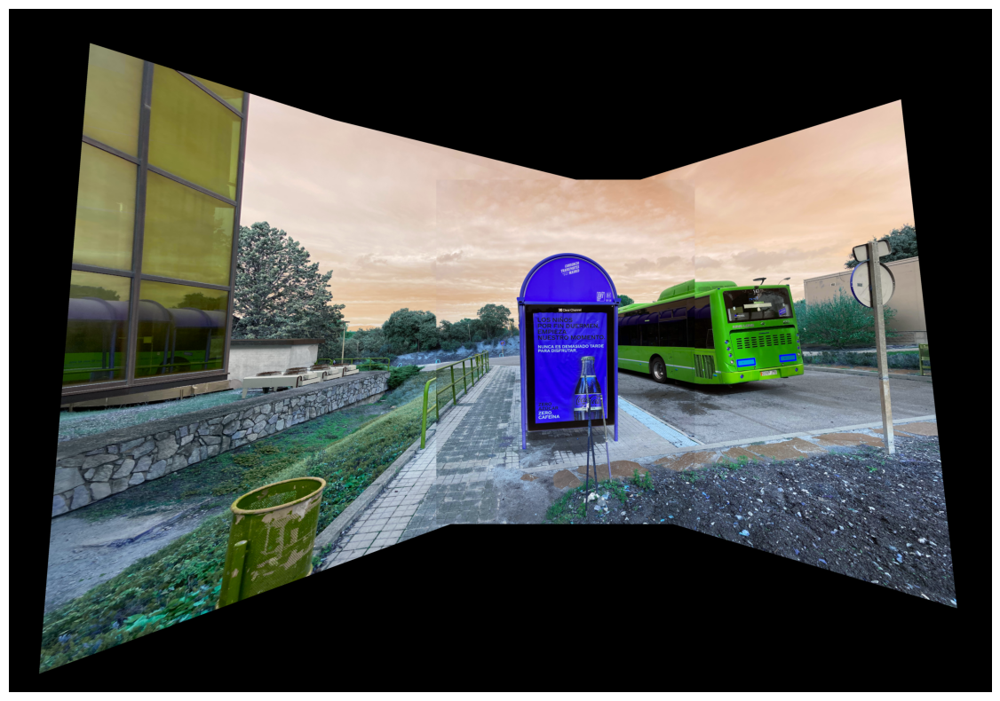

In [115]:
def superponer(proj_img,img2):
    mask = cv2.inRange(proj_img, 0,0) 
    mask_inv = cv2.bitwise_not(mask)
    cartel = cv2.bitwise_and(proj_img,proj_img,mask = mask_inv)
    fondo = cv2.bitwise_and(img2,img2,mask = mask)
    overlay = cv2.add(fondo,cartel)
    return overlay
resultado_final=imagen_final[fija]
resultado_final = superponer(resultado_final,imagen_final[0])
resultado_final = superponer(resultado_final,imagen_final[1])
resultado_final = superponer(resultado_final,imagen_final[2])
resultado_final = superponer(resultado_final,imagen_final[3])
resultado_final = resultado_final[7000:11000,5500:11250]
draw_images([resultado_final])


## **Optional 1 (1 pts)**: Spherical/cylindrical projection

In [ ]:
filenames = ["images/0.png", "images/1.png", "images/2.png", "images/3.png", "images/4.png", "images/5.png", "images/6.png"]

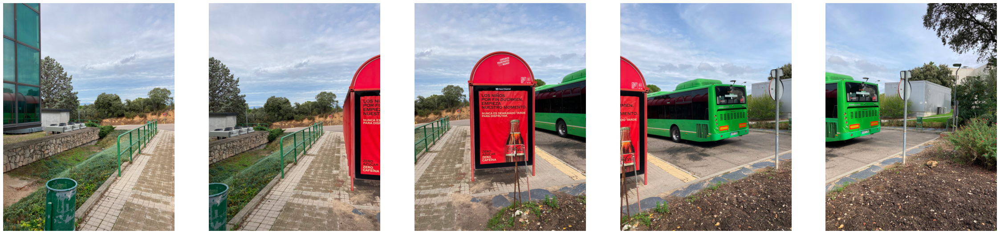

In [ ]:
### TODO
# Draw images

draw_images(imgs)

In [ ]:
### TODO
print(pano.shape)
# Draw image
fig = plt.figure()
plt.axis("off")
plt.imshow(pano);

NameError: name 'pano' is not defined

## **Optional 2 (1 pts)**: Eliminate the condition of naming the images in increasing order


In [33]:
def warpImages(img1, img2, M):
    # get the corner coordinates of the "query" and "train" image
    h1, w1 = img1.shape[:2]
    h2, w2 = img2.shape[:2]
    pts_corners_src = np.float32([[0, 0], [0, h1], [w1, h1], [w1, 0]]).reshape(-1, 1, 2)
    pts_corners_temp = np.float32([[0, 0], [0, h2], [w2, h2], [w2, 0]]).reshape(-1, 1, 2)

    # When we have established a homography we need to warp perspective
    # perform perspective tranform using previously calculated matrix and the corners of  
    #"query" image#
    # Change field of view
    pts_corners_dst = cv2.perspectiveTransform(pts_corners_temp, M)

    ListOfPoints = np.concatenate((pts_corners_src, pts_corners_dst), axis=0)

    [x_min, y_min] = np.int32(ListOfPoints.min(axis=0).ravel() - 0.5)
    [x_max, y_max] = np.int32(ListOfPoints.max(axis=0).ravel() + 0.5)

    translation_dist = [-x_min, -y_min]

    H_translation = np.array([[1, 0, translation_dist[0]], [0, 1, translation_dist[1]], [0, 0, 1]])

    new_img = cv2.warpPerspective(img2, H_translation.dot(M), (x_max - x_min, y_max - y_min))
    new_img[translation_dist[1]:h1 + translation_dist[1], translation_dist[0]:w1 + translation_dist[0]] = img1

    return new_img

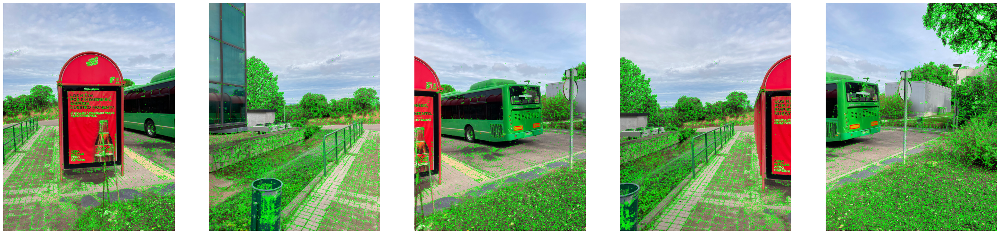

In [32]:
### TODO
filenames = ["images/3.png", "images/1.png", "images/4.png", "images/2.png", "images/5.png"]
imgs = [cv2.imread(img) for img in filenames]
### TODO
# Draw key points
sift =  cv2.SIFT_create()

_imgs = copy.deepcopy(imgs)
gray_imgs = []
for img in _imgs:
    gray_imgs += [cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)]

keypoints = []
descriptores = []
for img in gray_imgs:
    kp, des = sift.detectAndCompute(img, None)
    keypoints += [kp]
    descriptores += [des]

for idx in range(len(_imgs)):
    cv2.drawKeypoints(_imgs[idx], keypoints[idx], _imgs[idx], (0, 255, 0), flags=cv2.DRAW_MATCHES_FLAGS_DEFAULT)
draw_images(_imgs)

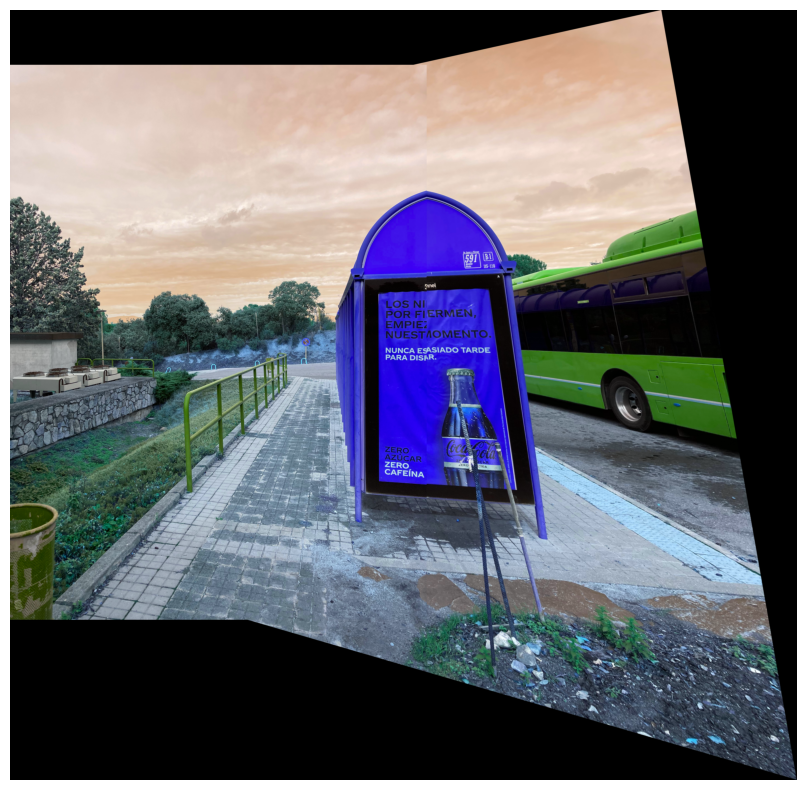

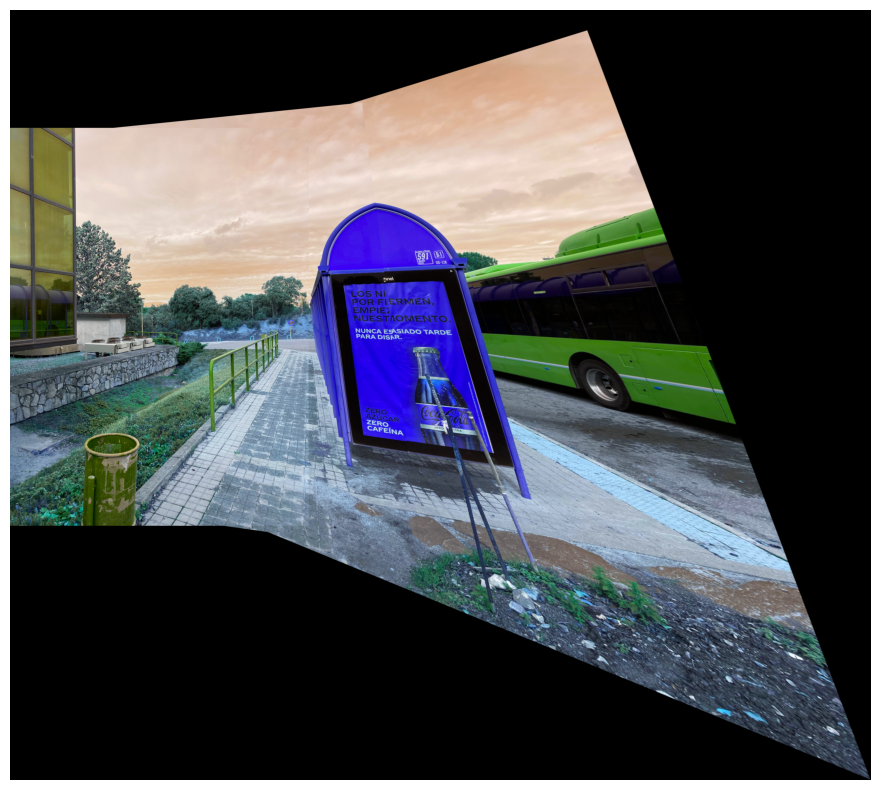

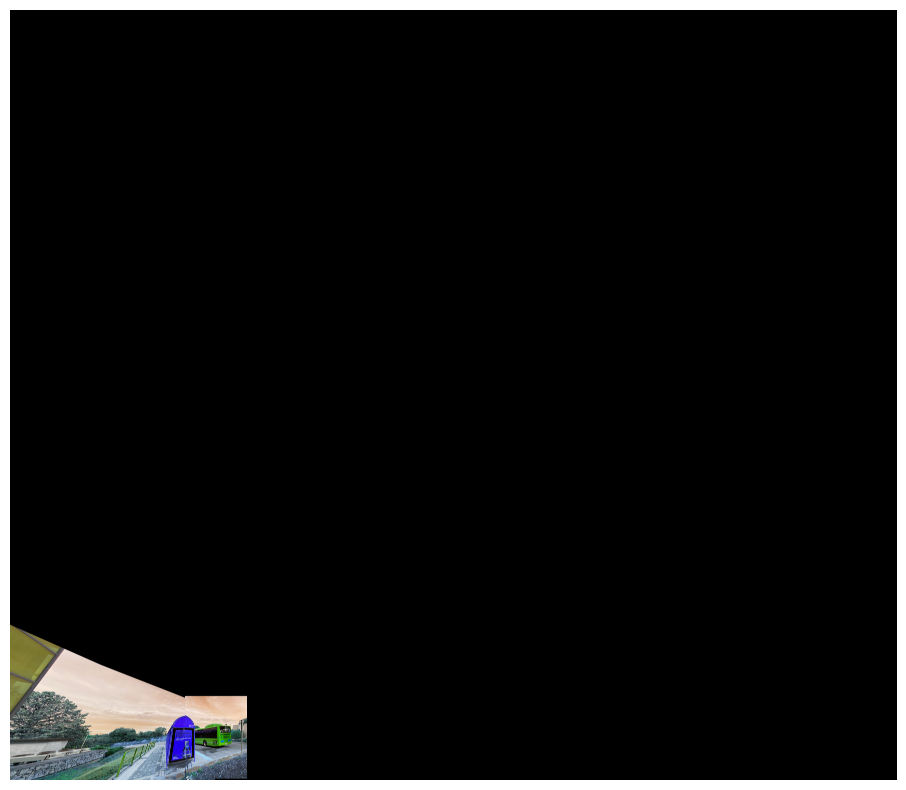

error: OpenCV(4.6.0) D:\a\opencv-python\opencv-python\opencv\modules\core\src\alloc.cpp:73: error: (-4:Insufficient memory) Failed to allocate 6509038784 bytes in function 'cv::OutOfMemoryError'


In [34]:
for i in range(len(imgs)-2):

    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
    matches = []
    primera = descriptores[0]
    for d in descriptores[1:]:
        matches += [bf.knnMatch(primera,d,k=2)]
    goods = []
    for match in matches:
        good = []
        for m, n in match:
            if m.distance < 0.70 * n.distance:
                good.append(m)
        goods.append(good)    

    good_matches_num = [len(good) for good in goods]

    index = good_matches_num.index(max(good_matches_num))

    correct_match = goods[index]

    src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in goods[index] ]).reshape(-1,1,2)
    dst_pts = np.float32([ keypoints[index+1][m.trainIdx].pt for m in goods[index] ]).reshape(-1,1,2)

    H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)

    dst=warpImages(imgs[index+1],imgs[0], H)
    draw_images([dst])

    new = cv2.cvtColor(dst, cv2.COLOR_BGR2GRAY)

    kp, des = sift.detectAndCompute(new, None)
    keypoints[0] = kp
    descriptores[0] = des

    del keypoints[index+1]
    del descriptores[index+1]

    imgs[0] = dst
    del imgs[index+1]

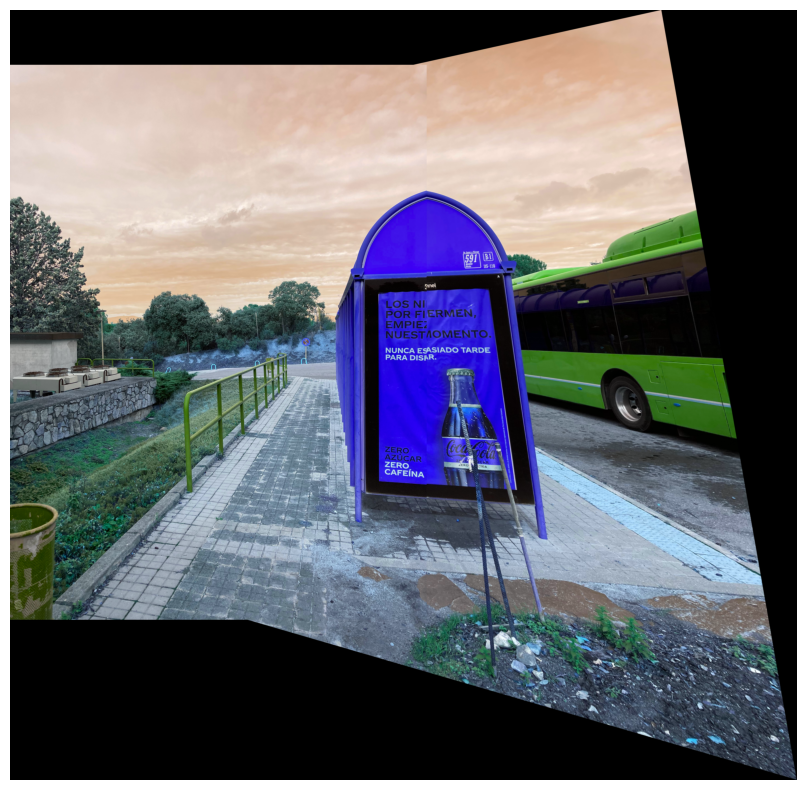

In [19]:
### TODO
# Draw all matches
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = []
primera = descriptores[0]
for d in descriptores[1:]:
    matches += [bf.knnMatch(primera,d,k=2)]
goods = []
for match in matches:
    good = []
    for m, n in match:
        if m.distance < 0.70 * n.distance:
            good.append(m)
    goods.append(good)    

good_matches_num = [len(good) for good in goods]

index = good_matches_num.index(max(good_matches_num))

correct_match = goods[index]

src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in goods[index] ]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints[index+1][m.trainIdx].pt for m in goods[index] ]).reshape(-1,1,2)

H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)

dst=warpImages(imgs[index+1],imgs[0], H)
draw_images([dst])










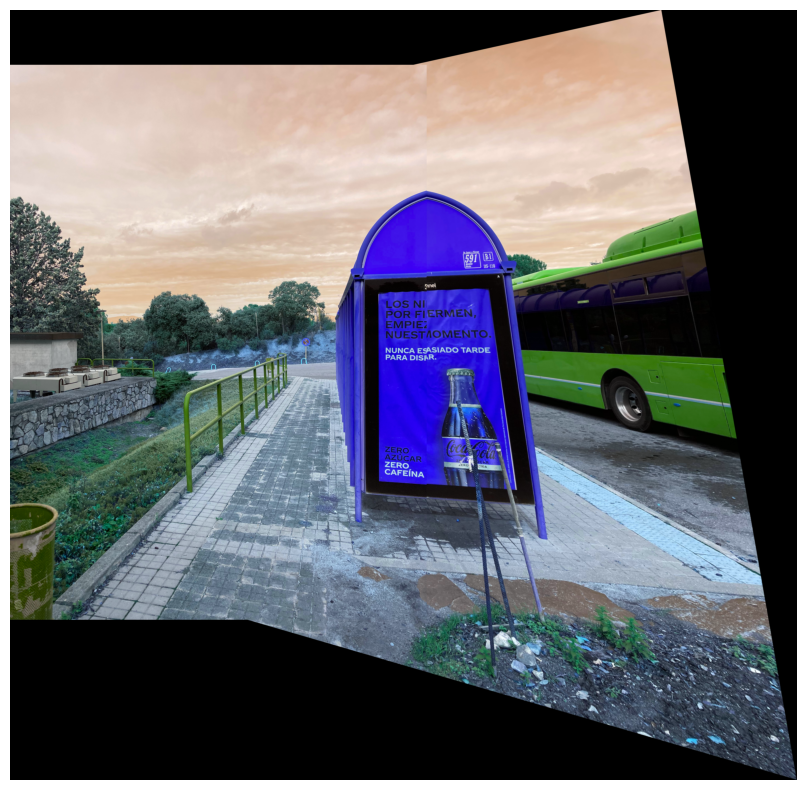

In [10]:
### TODO
# Draw all matches
bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=False)
matches = []
primera = descriptores[0]
for d in descriptores[1:]:
    matches += [bf.knnMatch(primera,d,k=2)]
goods = []
for match in matches:
    good = []
    for m, n in match:
        if m.distance < 0.70 * n.distance:
            good.append(m)
    goods.append(good)    

good_matches_num = [len(good) for good in goods]

index = good_matches_num.index(max(good_matches_num))

correct_match = goods[index]

src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in goods[index] ]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints[index+1][m.trainIdx].pt for m in goods[index] ]).reshape(-1,1,2)

H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)

dst=warpImages(imgs[index+1],imgs[0], H)
# draw_images([dst])

new = cv2.cvtColor(dst, cv2.COLOR_BGR2GRAY)

kp, des = sift.detectAndCompute(new, None)
keypoints[0] = [kp]
descriptores[0] = [des]

del keypoints[index+1]
del descriptores[index+1]

imgs[0] = new
del imgs[index+1]


matches = []
primera = descriptores[0]
for d in descriptores[1:]:
    matches += [bf.knnMatch(primera,d,k=2)]
goods = []
for match in matches:
    good = []
    for m, n in match:
        if m.distance < 0.70 * n.distance:
            good.append(m)
    goods.append(good)    

good_matches_num = [len(good) for good in goods]

index = good_matches_num.index(max(good_matches_num))

correct_match = goods[index]

src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in goods[index] ]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints[index+1][m.trainIdx].pt for m in goods[index] ]).reshape(-1,1,2)

H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)

dst2=warpImages(imgs[index+1],imgs[0], H)
draw_images([dst2])







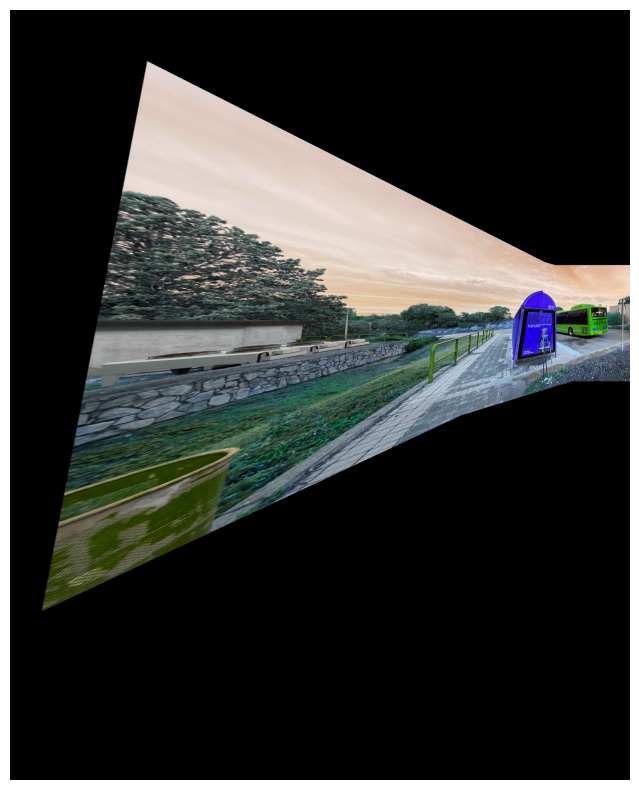

In [26]:
new = cv2.cvtColor(dst, cv2.COLOR_BGR2GRAY)

kp, des = sift.detectAndCompute(new, None)
keypoints[0] = kp
descriptores[0] = des

del keypoints[index+1]
del descriptores[index+1]

imgs[0] = dst
del imgs[index+1]


matches = []
primera = descriptores[0]
for d in descriptores[1:]:
    matches += [bf.knnMatch(primera,d,k=2)]
goods = []
for match in matches:
    good = []
    for m, n in match:
        if m.distance < 0.70 * n.distance:
            good.append(m)
    goods.append(good)    

good_matches_num = [len(good) for good in goods]

index = good_matches_num.index(max(good_matches_num))

correct_match = goods[index]

src_pts = np.float32([ keypoints[0][m.queryIdx].pt for m in goods[index] ]).reshape(-1,1,2)
dst_pts = np.float32([ keypoints[index+1][m.trainIdx].pt for m in goods[index] ]).reshape(-1,1,2)

H, inliers = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC,ransacReprojThreshold=10, maxIters=10)

dst2=warpImages(imgs[index+1],imgs[0], H)
draw_images([dst2])

In [25]:
imgs[2].shape

(2016, 1512, 3)

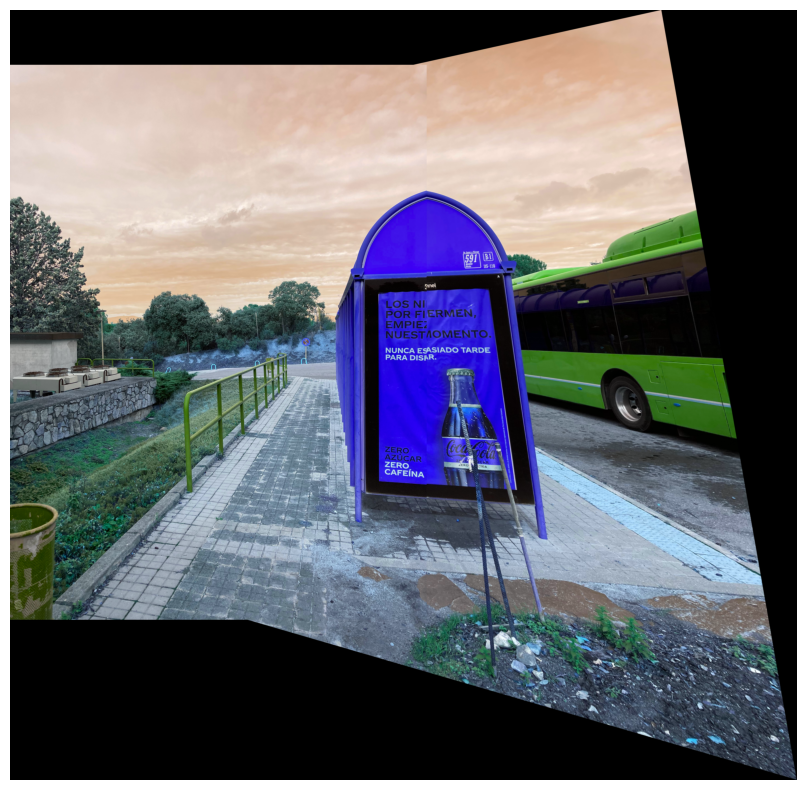

In [11]:
st=warpImages(imgs[index+1],imgs[0],  H)
draw_images([dst])

del descriptores[0]
del descriptores[index+1]

new = cv2.cvtColor(dst, cv2.COLOR_BGR2GRAY)

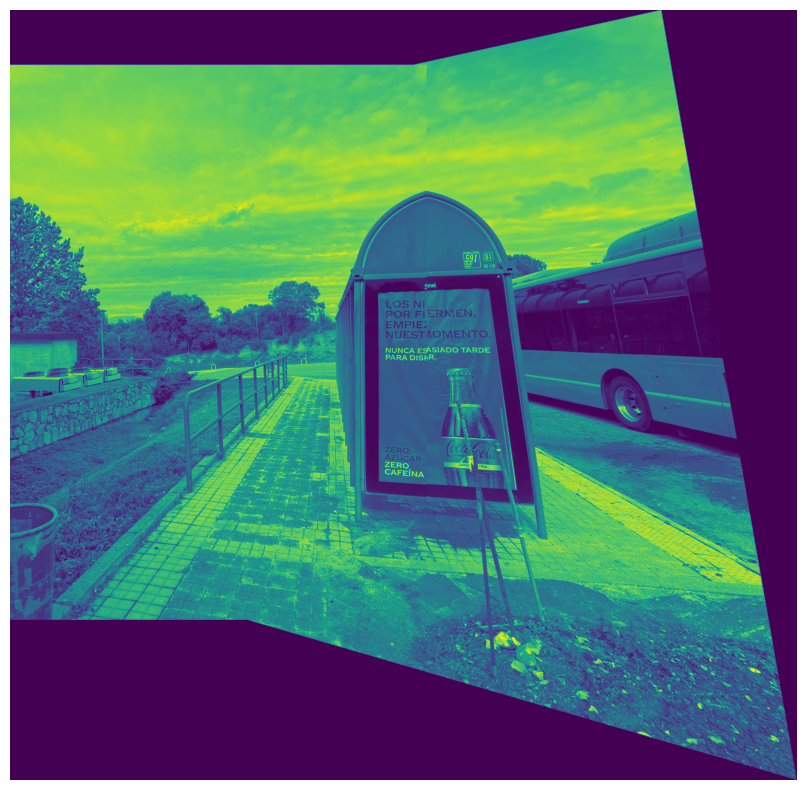

# Instructions for submission
Please write a document (pdf) describing the problem and the process that you have followed to reach your solutions. In your submission via Moodle, also include your Jupyter Notebook source file with the results of computations attached to the code which generated them.

The project assignment must be done in **groups of 3 students**. Each team must submit one report for the assignment.


Your report should be submitted by **Sunday, January 8th, 2023, 23:55 h**.
